In [2]:
"""
Santosh Omprakash
"""

'\nSantosh Omprakash\n'

### Milestone 2: Cleaning/Formatting Flat File Source

In [1]:
# Load necessary libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from fuzzywuzzy import fuzz 
from fuzzywuzzy import process

C:\Users\oneor\anaconda3\lib\site-packages\fuzzywuzzy\fuzz.py:11: UserWarning: Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning
  warnings.warn('Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning')


In [2]:
# Read craiglist car dataset
car_df = pd.read_csv("all_state_data.csv")

In [3]:
# Dispaly first few records
car_df.head(10)

,Unnamed: 0,price,cylinders,odometer,transmission,type,size,title_status,color,mileage,state,owner_dealer,year,brand,model
0,0,16590,n,38861,automatic,other,na,clean,na,na,alabama,dealer,2017,kia,sorento lx sport utility 4d
1,1,23990,6,42418,automatic,sedan,na,clean,silver,na,alabama,dealer,2016,lexus,es 350 sedan 4d
2,2,13990,n,26324,automatic,other,na,clean,na,na,alabama,dealer,2017,buick,encore preferred sport
3,3,36990,6,20061,automatic,coupe,na,clean,black,na,alabama,dealer,2017,jaguar,f-type coupe 2d
4,4,9000,6,279000,automatic,SUV,na,clean,black,na,alabama,owner,2008,jeep,wrangler
5,5,10977,n,209837,manual,na,na,clean,white,na,alabama,dealer,2001,ford,f-250
6,6,1977,n,238757,manual,na,na,clean,na,na,alabama,dealer,2003,mitsubishi,lancer
7,7,21590,n,21446,automatic,hatchback,na,clean,silver,na,alabama,dealer,2018,subaru,crosstrek 2.0i premium
8,8,14950,6,127000,automatic,na,na,clean,na,na,alabama,owner,2011,ford,f-150
9,9,16400,6,na,automatic,mini-van,full-size,lien,silver,na,alabama,owner,2013,toyota,sienna


In [4]:
# Find total number of records
car_df.shape

(175626, 15)

#### As seen above, dataset has 15 columns

In [5]:
# Replace headers
car_df1 = car_df.rename(columns={"Unnamed: 0": "ID", "price": "price_USD", "type": "style", "brand": "make"})
car_df1

,ID,price_USD,cylinders,odometer,transmission,style,size,title_status,color,mileage,state,owner_dealer,year,make,model
0,0,16590,n,38861,automatic,other,na,clean,na,na,alabama,dealer,2017,kia,sorento lx sport utility 4d
1,1,23990,6,42418,automatic,sedan,na,clean,silver,na,alabama,dealer,2016,lexus,es 350 sedan 4d
2,2,13990,n,26324,automatic,other,na,clean,na,na,alabama,dealer,2017,buick,encore preferred sport
3,3,36990,6,20061,automatic,coupe,na,clean,black,na,alabama,dealer,2017,jaguar,f-type coupe 2d
4,4,9000,6,279000,automatic,SUV,na,clean,black,na,alabama,owner,2008,jeep,wrangler
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175621,636,3500,n,na,automatic,na,na,clean,na,na,wyoming,owner,1990,toyota,4runner
175622,637,15160,n,na,other,na,na,clean,na,na,wyoming,dealer,2011,chevrolet,silverado 1500
175623,638,19312,n,na,other,na,na,clean,na,na,wyoming,dealer,2015,jeep,cherokee
175624,639,2200,8,265000,automatic,SUV,full-size,clean,blue,na,wyoming,owner,1999,ford,expedition


In [9]:
# Create dataframe without ID
car_df2 = car_df1[['make', 'model', 'price_USD', 'cylinders', 'odometer', 'transmission', 'style', 'size', 'title_status', 'color',
                   'mileage', 'state', 'owner_dealer', 'year']]

In [19]:
# Remove duplicates
car_df3 = car_df2.drop_duplicates() 

In [11]:
# Format data into a more readable format
def color_code(value):
  """
  Colors elements in dateframe based on values. Here tile status clean is coded as green color and rest as red color.
  """

  if value == 'clean':
    color = 'green'
  else:
    color = 'red'

  return 'color: %s' % color

In [12]:
car_df3.style.applymap(color_code, subset=['title_status'])

In [13]:
# Fix casing or inconsistent values
# Replace na or n values with NaN
car_df3 = car_df3.replace("na", np.NaN)
car_df3 = car_df3.replace("n", np.NaN)
car_df3.head()

,make,model,price_USD,cylinders,odometer,transmission,style,size,title_status,color,mileage,state,owner_dealer,year
0,kia,sorento lx sport utility 4d,16590,NaN,38861,automatic,other,NaN,clean,NaN,NaN,alabama,dealer,2017
1,lexus,es 350 sedan 4d,23990,6,42418,automatic,sedan,NaN,clean,silver,NaN,alabama,dealer,2016
2,buick,encore preferred sport,13990,NaN,26324,automatic,other,NaN,clean,NaN,NaN,alabama,dealer,2017
3,jaguar,f-type coupe 2d,36990,6,20061,automatic,coupe,NaN,clean,black,NaN,alabama,dealer,2017
4,jeep,wrangler,9000,6,279000,automatic,SUV,NaN,clean,black,NaN,alabama,owner,2008


In [14]:
# Identify outliers and bad data
# The dataset shows bad data in 'Make' column where there are numeric values.
car_df3['make'] = car_df3['make'].where(car_df3['make'].str.isalpha())

In [15]:
car_df4 = car_df3[car_df3['make'].notna()]
car_df4

,make,model,price_USD,cylinders,odometer,transmission,style,size,title_status,color,mileage,state,owner_dealer,year
0,kia,sorento lx sport utility 4d,16590,NaN,38861,automatic,other,NaN,clean,NaN,NaN,alabama,dealer,2017
1,lexus,es 350 sedan 4d,23990,6,42418,automatic,sedan,NaN,clean,silver,NaN,alabama,dealer,2016
2,buick,encore preferred sport,13990,NaN,26324,automatic,other,NaN,clean,NaN,NaN,alabama,dealer,2017
3,jaguar,f-type coupe 2d,36990,6,20061,automatic,coupe,NaN,clean,black,NaN,alabama,dealer,2017
4,jeep,wrangler,9000,6,279000,automatic,SUV,NaN,clean,black,NaN,alabama,owner,2008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175103,jeep,cherokee sport,16995,6,105421,automatic,SUV,mid-size,clean,black,NaN,wyoming,dealer,2017
175106,cadillac,cts,9000,6,NaN,automatic,NaN,NaN,clean,brown,NaN,wyoming,owner,2009
175107,ford,f150 supercrew,26999,6,82500,automatic,truck,full-size,clean,grey,NaN,wyoming,owner,2017
175108,volkswagen,gti,17000,NaN,47000,automatic,NaN,NaN,clean,NaN,NaN,wyoming,owner,2016


{'whiskers': [<matplotlib.lines.Line2D at 0x1d83b4e9788>,
 'caps': [<matplotlib.lines.Line2D at 0x1d83b4f6748>,
 'boxes': [<matplotlib.lines.Line2D at 0x1d83b4f2c08>],
 'medians': [<matplotlib.lines.Line2D at 0x1d83b4fce08>],
 'fliers': [<matplotlib.lines.Line2D at 0x1d83b4f4548>],
 'means': []}

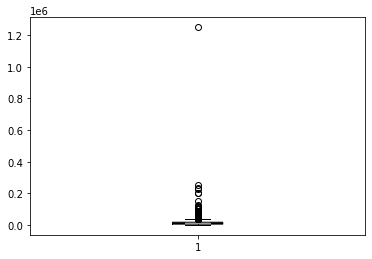

In [15]:
# Identify outliers and bad data
plt.boxplot(car_df4.price_USD, notch=True)

#### Above plot shows outlier above value of ~$30,000

In [16]:
choices = car_df4['make'].unique()
choices[:15]

array(['kia', 'lexus', 'buick', 'jaguar', 'jeep', 'ford', 'mitsubishi',
       'subaru', 'toyota', 'chrysler', 'ram', 'pontiac', 'infiniti',
       'honda', 'hyundai'], dtype=object)

In [17]:
# find the percentage match for invalid values using fuzzy match
process.extract("hond", choices, limit=30, scorer=fuzz.token_sort_ratio)

[('honda', 89),
 ('honday', 80),
 ('honddda', 73),
 ('hyndai', 60),
 ('hyundai', 55),
 ('diamond', 55),
 ('hyundia', 55),
 ('ford', 50),
 ('land', 50),
 ('hino', 50),
 ('dode', 50),
 ('town', 50),
 ('handicap', 50),
 ('food', 50),
 ('southwind', 46),
 ('dodge', 44),
 ('scion', 44),
 ('yukon', 44),
 ('grand', 44),
 ('sonic', 44),
 ('tahoe', 44),
 ('crown', 44),
 ('avalon', 40),
 ('scaion', 40),
 ('toyoda', 40),
 ('accord', 40),
 ('pontiac', 36),
 ('lincoln', 36),
 ('hackney', 36),
 ('hyumdai', 36)]

#### Above result shows values above 70 can be considered and value can be replaced

In [18]:
process.extract("toya", choices, limit=30, scorer=fuzz.token_sort_ratio)

[('toyota', 80),
 ('toyoda', 80),
 ('totyota', 73),
 ('toyaota', 73),
 ('oyota', 67),
 ('tlyota', 60),
 ('town', 50),
 ('honda', 44),
 ('metro', 44),
 ('tesla', 44),
 ('tahoe', 44),
 ('hyndai', 40),
 ('custom', 40),
 ('earthroamer', 40),
 ('honday', 40),
 ('yamaha', 40),
 ('dakota', 40),
 ('pontiac', 36),
 ('hyundai', 36),
 ('honddda', 36),
 ('bentley', 36),
 ('mustang', 36),
 ('hyundia', 36),
 ('polaris', 36),
 ('hyumdai', 36),
 ('odyssey', 36),
 ('dynamic', 36),
 ('international', 35),
 ('infinity', 33),
 ('am', 33)]

In [23]:
# Replace row values based on the fuzzy match results
car_df4 = car_df4.replace('honday', 'honda')
car_df4 = car_df4.replace('honddda', 'honda')
car_df4 = car_df4.replace('toyoda', 'toyota')
car_df4 = car_df4.replace('totyota', 'toyota')
car_df4 = car_df4.replace('toyaota', 'toyota')
car_df4 = car_df4.replace('oyota', 'toyota')
car_df4 = car_df4.replace('tlyota', 'toyota')
car_df4 = car_df4.replace('chevy', 'CHEVROLET')

In [16]:
car_df4.loc[car_df4['make'] == 'mercedes-benz']

,make,model,price_USD,cylinders,odometer,transmission,style,size,title_status,color,mileage,state,owner_dealer,year


In [20]:
# Example to apply fuzzy match to specfic column and replace value
def get_ratio(row):
    name = row['make']
    return fuzz.token_sort_ratio(name, "chev")

car_df4[car_df4.apply(get_ratio, axis=1) > 70]

,make,model,price_USD,cylinders,odometer,transmission,style,size,title_status,color,mileage,state,owner_dealer,year
2799,chevy,m1008,5000,8,27000,automatic,truck,full-size,clean,green,NaN,alaska,owner,1989
2812,chevy,express 3500,7950,8,72132,automatic,van,full-size,clean,white,NaN,alaska,dealer,2000
2818,chevy,silverado 1500,14950,NaN,NaN,automatic,NaN,NaN,clean,NaN,NaN,alaska,dealer,2010
2821,chevy,NaN,9900,NaN,NaN,automatic,NaN,NaN,clean,NaN,NaN,alaska,owner,2008
2830,chevy,impala,5950,6,102405,automatic,sedan,mid-size,clean,black,NaN,alaska,dealer,2012
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
169240,chevy,silverado lt crew cab,20992,8,131215,automatic,NaN,NaN,clean,NaN,NaN,wisconsin,dealer,2015
172096,chevy,colorado,19900,6,12722,automatic,truck,full-size,rebuilt,red,NaN,wisconsin,dealer,2019
172120,chevy,cruz lt,5999,NaN,157498,automatic,NaN,NaN,clean,NaN,NaN,wisconsin,dealer,2012
174994,chevy,trax,13500,NaN,NaN,automatic,NaN,NaN,clean,NaN,NaN,wyoming,owner,2017


In [22]:
def get_ratio(row):
    name = row['make']
    return fuzz.token_sort_ratio(name, "CHEVROLET")

car_df4[car_df4.apply(get_ratio, axis=1) > 70]

,make,model,price_USD,cylinders,odometer,transmission,style,size,title_status,color,mileage,state,owner_dealer,year
51,chevrolet,silverado 1500,6980,8,120556,automatic,pickup,NaN,NaN,grey,NaN,alabama,dealer,2004
63,chevrolet,malibu,2900,4,163000,automatic,sedan,compact,clean,white,NaN,alabama,owner,2012
65,chevrolet,c10,4700,6,NaN,manual,pickup,NaN,missing,red,NaN,alabama,owner,1969
66,chevrolet,malibu,4300,4,196478,automatic,sedan,NaN,clean,NaN,NaN,alabama,dealer,2011
79,chevrolet,traverse,6980,6,189541,manual,SUV,NaN,NaN,white,NaN,alabama,dealer,2011
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175074,chevrolet,suburban,3500,8,201173,automatic,SUV,full-size,clean,grey,NaN,wyoming,owner,2002
175077,chevrolet,silverado,22000,8,99500,automatic,truck,full-size,clean,green,NaN,wyoming,owner,2015
175081,chevrolet,silverado 3500 lt,9395,NaN,NaN,automatic,NaN,NaN,clean,NaN,NaN,wyoming,dealer,2008
175093,chevrolet,uplander ls,2500,NaN,162157,automatic,mini-van,NaN,clean,silver,NaN,wyoming,owner,2008


In [24]:
car_df4.to_csv(r'C:\Users\oneor\Downloads\Untitled Folder\cars_from_file.csv', index = False)

In [26]:
car_df4.tail()

,make,model,price_USD,cylinders,odometer,transmission,style,size,title_status,color,mileage,state,owner_dealer,year
175103,jeep,cherokee sport,16995,6,105421,automatic,SUV,mid-size,clean,black,NaN,wyoming,dealer,2017
175106,cadillac,cts,9000,6,NaN,automatic,NaN,NaN,clean,brown,NaN,wyoming,owner,2009
175107,ford,f150 supercrew,26999,6,82500,automatic,truck,full-size,clean,grey,NaN,wyoming,owner,2017
175108,volkswagen,gti,17000,NaN,47000,automatic,NaN,NaN,clean,NaN,NaN,wyoming,owner,2016
175109,international,eagle,25000,6,910592,manual,truck,NaN,clean,purple,NaN,wyoming,owner,1998


In [28]:
car_df4.isnull().tail()

,make,model,price_USD,cylinders,odometer,transmission,style,size,title_status,color,mileage,state,owner_dealer,year
175103,False,False,False,False,False,False,False,False,False,False,True,False,False,False
175106,False,False,False,False,True,False,True,True,False,False,True,False,False,False
175107,False,False,False,False,False,False,False,False,False,False,True,False,False,False
175108,False,False,False,True,False,False,True,True,False,True,True,False,False,False
175109,False,False,False,False,False,False,False,True,False,False,True,False,False,False


In [29]:
car_df4.notnull().tail()

,make,model,price_USD,cylinders,odometer,transmission,style,size,title_status,color,mileage,state,owner_dealer,year
175103,True,True,True,True,True,True,True,True,True,True,False,True,True,True
175106,True,True,True,True,False,True,False,False,True,True,False,True,True,True
175107,True,True,True,True,True,True,True,True,True,True,False,True,True,True
175108,True,True,True,False,True,True,False,False,True,False,False,True,True,True
175109,True,True,True,True,True,True,True,False,True,True,False,True,True,True


In [30]:
car_df4.isnull().sum()

make                0
model             142
price_USD           0
cylinders        3755
odometer         1892
transmission       34
style            3125
size             6807
title_status       35
color            3187
mileage         10512
state               0
owner_dealer        0
year                0
dtype: int64

In [36]:
car_df4.dropna(how='all').shape

(10512, 14)

In [38]:
car_df4.dropna(subset=['model', 'title_status'])

,make,model,price_USD,cylinders,odometer,transmission,style,size,title_status,color,mileage,state,owner_dealer,year
0,kia,sorento lx sport utility 4d,16590,NaN,38861,automatic,other,NaN,clean,NaN,NaN,alabama,dealer,2017
1,lexus,es 350 sedan 4d,23990,6,42418,automatic,sedan,NaN,clean,silver,NaN,alabama,dealer,2016
2,buick,encore preferred sport,13990,NaN,26324,automatic,other,NaN,clean,NaN,NaN,alabama,dealer,2017
3,jaguar,f-type coupe 2d,36990,6,20061,automatic,coupe,NaN,clean,black,NaN,alabama,dealer,2017
4,jeep,wrangler,9000,6,279000,automatic,SUV,NaN,clean,black,NaN,alabama,owner,2008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175103,jeep,cherokee sport,16995,6,105421,automatic,SUV,mid-size,clean,black,NaN,wyoming,dealer,2017
175106,cadillac,cts,9000,6,NaN,automatic,NaN,NaN,clean,brown,NaN,wyoming,owner,2009
175107,ford,f150 supercrew,26999,6,82500,automatic,truck,full-size,clean,grey,NaN,wyoming,owner,2017
175108,volkswagen,gti,17000,NaN,47000,automatic,NaN,NaN,clean,NaN,NaN,wyoming,owner,2016
